<a href="https://colab.research.google.com/github/fazekas-gergo/composer-ai/blob/master/ComposerAI_ipynb_multioutput_model.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Composer AI
Authors: Fazekas Gergő and Joseph Tadrous<br>
Used dataset: https://www.kaggle.com/soumikrakshit/classical-music-midi

---
## 1. First steps
At first clone the repository (which also contains the dataset) and install the required packages.

In [1]:
!git clone -l -s https://github.com/fazekas-gergo/composer-ai composer-ai
%cd composer-ai
!pip install midi2audio
!pip install py_midicsv
!pip install pretty_midi
!sudo apt-get install fluidsynth

Cloning into 'composer-ai'...
remote: Enumerating objects: 387, done.
remote: Counting objects: 100% (387/387), done.
remote: Compressing objects: 100% (381/381), done.
remote: Total 387 (delta 35), reused 329 (delta 3), pack-reused 0
Receiving objects: 100% (387/387), 84.80 MiB | 11.76 MiB/s, done.
Resolving deltas: 100% (35/35), done.
/content/composer-ai
     |████████████████████████████████| 96 kB 4.7 MB/s 
  Attempting uninstall: click
    Found existing installation: click 7.1.2
    Uninstalling click-7.1.2:
      Successfully uninstalled click-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flask 1.1.4 requires click<8.0,>=5.1, but you have click 8.1.2 which is incompatible.
     |████████████████████████████████| 5.6 MB 7.2 MB/s 
     |████████████████████████████████| 51 kB 8.7 MB/s 
  Created wheel for pretty-midi: filename=pretty_midi-0.2.9-py

In [2]:
import os
import pretty_midi
import collections
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import music21
from sklearn.preprocessing import MinMaxScaler

from midi2audio import FluidSynth
from IPython.display import Audio

---
## 2. Data Familiarization
The *convert_midi_to_flac* function is able to convert the midi file to be listenable by using a soundfont file.

In [3]:
def convert_midi_to_flac(music_path, output='music'):
  FluidSynth('piano.sf2').midi_to_audio(music_path, 'music' + '.flac')
  return 'music' + '.flac'

def play_music(music_path):
  convert_midi_to_flac(music_path, output='music')
  return 'music.flac'

Audio(play_music('classical_music_midi/albeniz/alb_esp1.mid'))

The *music21* package lets us to plot the midi file.

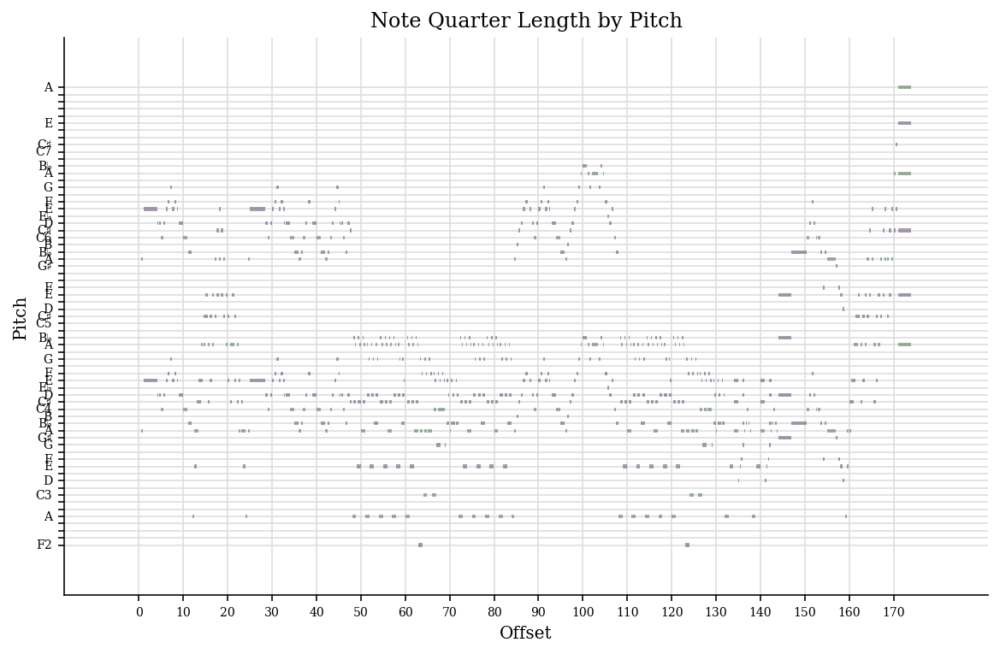

In [4]:
music = music21.converter.parse('classical_music_midi/albeniz/alb_esp1.mid')
music.plot()

---
## 3. Data preparation
At first let's create a list, which contains all the midi files from the dataset.

In [5]:
def get_midi_files(main_folder):
  files = []
  for dir in os.listdir(main_folder):
    for file in os.listdir(main_folder + os.path.sep + dir):
      files.append(main_folder + os.path.sep + dir + os.path.sep + file)
  return files

midi_files = get_midi_files('classical_music_midi')
print('Number of read MIDI files:', len(midi_files))

Number of read MIDI files: 295


In [6]:
Audio(play_music(midi_files[251]))

Secondly, create a pandas data frame filled with the pitches and durations of the notes sorted by the start time.<br>

In [8]:
from pretty_midi.instrument import Instrument

def midi_file_to_df(midi_file_name: str):
  m = pretty_midi.PrettyMIDI(midi_file_name)
  piano_left = list(filter(lambda inst: inst.name.lower() == 'piano left', m.instruments))
  piano_right = list(filter(lambda inst: inst.name.lower() == 'piano right', m.instruments))
  if len(piano_left) == 1 and len(piano_right) == 1:
     return piano_to_df(piano_left[0], piano_right[0])

def piano_to_df(piano_left: Instrument, piano_right: Instrument):
  dataset = []
  piano_notes_df = __create_df_from_piano_notes(piano_left, piano_right)
  # Group notes by their start to  handle them together
  for start, note_df in piano_notes_df.groupby(['start']):
    pitches = __create_pitch_arr(note_df)
    duration = (note_df['end'] - start).mean()
    velocity = note_df['velocity'].mean()
    dataset.append([pitches, duration, velocity])
  return pd.DataFrame(dataset, columns=['pitches', 'duration', 'velocity'])

def __create_df_from_piano_notes(piano_left: Instrument, piano_right: Instrument):
  piano_left_df = __create_df_from_instrument_notes(piano_left)
  piano_right_df = __create_df_from_instrument_notes(piano_right)
  return pd.concat([piano_left_df, piano_right_df]).sort_values(['start'])

def __create_df_from_instrument_notes(instrument: Instrument):
  return pd.DataFrame([{
        'start': n.start, 
        'end': n.end, 
        'pitch': n.pitch, 
        'velocity': n.velocity
    } for n in instrument.notes])

def __create_pitch_arr(note_df):
  note = np.zeros(108-21)
  for _, d in note_df.iterrows():
    pitch = int(d['pitch'])
    note[pitch - 21] = 1
  return note

df = midi_file_to_df(midi_files[251])
df

,pitches,duration,velocity
0,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",2.108222,26.000
1,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.009608,26.375
2,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",1.180887,27.250
3,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",3.591972,32.500
4,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.527055,39.000
...,...,...,...
1922,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.201850,19.000
1923,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.215381,23.000
1924,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.229514,17.000
1925,"[0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, ...",0.366301,22.000


In [9]:
df.describe()

,duration,velocity
count,1927.000000,1927.000000
mean,0.323561,40.807070
std,0.548175,20.018859
min,0.060000,14.000000
25%,0.118371,27.500000
50%,0.135453,32.000000
75%,0.294706,44.000000
max,4.793275,97.000000


Remove outliers

In [10]:
df_filtered = df[(df.duration < df.duration.quantile(.9))].reset_index(drop=True)
df_filtered.describe()

,duration,velocity
count,1733.000000,1733.000000
mean,0.187222,41.193989
std,0.114694,20.898545
min,0.060000,17.000000
25%,0.117495,27.000000
50%,0.125586,31.000000
75%,0.246873,46.166667
max,0.540496,97.000000


In [11]:
scaler = MinMaxScaler()
scaler.fit(df_filtered[['duration', 'velocity']])
scaled = scaler.transform(df_filtered[['duration', 'velocity']])
df_scaled = pd.DataFrame(scaled, columns=['duration', 'velocity'])
df_scaled['pitches'] = df_filtered['pitches']
df_scaled.describe()

,duration,velocity
count,1733.000000,1733.000000
mean,0.264771,0.302425
std,0.238700,0.261232
min,0.000000,0.000000
25%,0.119658,0.125000
50%,0.136497,0.175000
75%,0.388917,0.364583
max,1.000000,1.000000


Finally, the definition of the **X** (features) and **Y** (targets) matrixes.<br>
The modell has to guess the next note's parameters.

In [26]:
window_size = 2

def make_timeseries_instances(timeseries, window_size):
    timeseries = np.asarray(timeseries)
    assert 0 < window_size < timeseries.shape[0] , "Out of range 0 < {} < {} ".format(window_size,timeseries.shape[0])
    X = np.atleast_3d(np.array([timeseries[start:start + window_size] for start in range(0, timeseries.shape[0] - window_size)]))
    Y = timeseries[window_size:]
    return X, Y

X_pitches, Y_pitches = make_timeseries_instances(df_scaled['pitches'].values, window_size=window_size)
X_dur_vel, Y_dur_vel = make_timeseries_instances(df_scaled[['duration', 'velocity']], window_size=window_size)



---
# Training


In [15]:
from tensorflow import keras
from tensorflow.keras.layers import LSTM, Dense, Dropout, Conv2D, Flatten, Reshape, Input, Concatenate
from tensorflow.keras.models import Model
from tensorflow.keras.initializers import HeNormal
from tensorflow.keras.losses import MeanSquaredError, BinaryCrossentropy

In [31]:
input_pitches = Input(shape=(window_size, 108-21))
input_dur_vel = Input(shape=(window_size, 2))

# the first branch operates on the pitches input
pitch_in = LSTM(108-21)(input_pitches)
pitch_in = Dense(108-21, activation="relu")(pitch_in)
pitch_in = Dense(108-21, activation="relu")(pitch_in)
pitch_in = Dense(30, activation="sigmoid")(pitch_in)
pitch_in = Model(inputs=input_pitches, outputs=pitch_in)

# the second branch opreates on the duration and velocity inputs
dur_vel_in = LSTM(5)(input_dur_vel)
dur_vel_in = Dense(64, activation="relu")(input_dur_vel)
dur_vel_in = Dense(32, activation="relu")(dur_vel_in)
dur_vel_in = Dense(4, activation="relu")(dur_vel_in)
dur_vel_in = Model(inputs=input_dur_vel, outputs=dur_vel_in)

# combine the output of the two branches
common_input = Concatenate([pitch_in.output, dur_vel_in.output])

# apply a FC layer and then a regression prediction on the
# combined outputs
common = Dense(30, activation="relu")(common_input)
pitch_output = Dense(108-21, activation="sigmoid")(common)
dur_vel_output = Dense(2, activation='sigmoid')(common)
model = Model(inputs=[pitch_in.input, dur_vel_in.input], outputs=[pitch_output.output, dur_vel_output.output])

model.compile(loss=[BinaryCrossentropy(), MeanSquaredError()], loss_weights=[0.7, 0.3], optimizer=keras.optimizers.Adam())
model.summary()

TypeError: ignored

In [ ]:
es = keras.callbacks.EarlyStopping(patience=20, monitor='val_loss', restore_best_weights=True, verbose=1)
model.fit([X_pitches, X_dur_vel], [Y_pitches, Y_dur_vel], epochs=1000, callbacks=[es], batch_size=2048, validation_split=0.1)

Save model

In [ ]:
from datetime import datetime
import subprocess

# Save model
path = "models/" + str(datetime.now().strftime("%m-%d-%Y_%H-%M-%S"))
model.save(path)

# Zip model to be downloadable
subprocess.call(['zip', '-r', path + ".zip", path])

INFO:tensorflow:Assets written to: models/04-04-2022_15-45-02/assets


INFO:tensorflow:Assets written to: models/04-04-2022_15-45-02/assets


0

---
# Transfer learning
the idea is to train the ready model with only one music piece.

In [ ]:
# TODO update
from tensorflow.keras.models import load_model

loaded_model = load_model(path)
loaded_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 64)                17408     
                                                                 
 dense (Dense)               (None, 100)               6500      
                                                                 
 dense_1 (Dense)             (None, 100)               10100     
                                                                 
 dense_2 (Dense)             (None, 50)                5050      
                                                                 
 output (Dense)              (None, 3)                 153       
                                                                 
Total params: 39,211
Trainable params: 39,211
Non-trainable params: 0
_________________________________________________________________


In [ ]:
music_file = 'classical_music_midi/mozart/mz_331_3.mid'
m = pretty_midi.PrettyMIDI(music_file)
m.instruments

[Instrument(program=0, is_drum=False, name="Piano right"),
 Instrument(program=0, is_drum=False, name="Piano left")]

In [ ]:
scaled = scaler.transform(instrument_to_df(m.instruments[0]))
df_scaled = pd.DataFrame(scaled, columns=['pitch','step','duration'])
df_scaled

,pitch,step,duration
0,0.581395,0.000000,0.154035
1,0.558140,0.214128,0.154035
2,0.546512,0.214128,0.154035
3,0.558140,0.214128,0.175047
4,0.593023,0.243108,0.154035
...,...,...,...
1507,0.639535,0.000000,0.780232
1508,0.697674,1.077777,0.780232
1509,0.558140,0.000000,0.780232
1510,0.604651,0.000000,0.780232


In [ ]:
X = sliding_window_view(df_scaled.drop(df_scaled.tail(1).index), window_shape=(win_len, 3))
X = X.reshape(X.shape[0], X.shape[2], X.shape[3])
Y = df_scaled.drop(range(win_len), axis='index').values

# Test
print((X[0].flatten() == df_scaled[0:win_len].values.flatten()).all())
print((Y[0] == df_scaled.iloc[win_len].values).all())

True
True


In [ ]:
from tensorflow.keras.optimizers import SGD
loaded_model.compile(optimizer=SGD(lr=0.0001, momentum=0.9), loss=keras.losses.MeanSquaredError())
es = keras.callbacks.EarlyStopping(patience=50, monitor='loss', restore_best_weights=True, verbose=1)
loaded_model.fit(X, Y, epochs=1000, callbacks=[es], batch_size=10)



---
# Generate music
Write output into a midi file and listen it


In [ ]:
# TODO update
def generate(num: int):
  num = num + win_len
  preds = np.zeros(shape=(num, 3))
  #preds[:win_len] = X[0]
  for i in range(num-win_len):
    input = preds[i:i+win_len].reshape(win_len, 3)
    new_pred = loaded_model.predict(preds[i:i+win_len].reshape(1, win_len, 3)).reshape(3)
    preds[i+win_len] = new_pred
  preds = preds[win_len:]
  return scaler.inverse_transform(preds.reshape(-1, 3))

generated = generate(1024)
generated = pd.DataFrame(generated, columns=['pitch',	'step',	'duration'])
generated

,pitch,step,duration
0,27.836459,0.012523,0.035971
1,29.136120,0.006776,0.045266
2,29.829660,0.005884,0.052249
3,31.862131,0.009336,0.057187
4,32.720521,0.020974,0.059171
...,...,...,...
1019,56.211028,0.007519,0.267493
1020,56.211028,0.007519,0.267493
1021,56.211028,0.007519,0.267493
1022,56.211023,0.007519,0.267493


In [ ]:
music = pretty_midi.PrettyMIDI()
piano = pretty_midi.Instrument(program=pretty_midi.instrument_name_to_program('Acoustic Grand Piano'))

start = 0
for index, p in generated.iterrows():
  note_number = round(p.pitch)
  note = pretty_midi.Note(velocity=100, pitch=note_number, 
                          start=start, end=start+p.duration)
  piano.notes.append(note)
  start += p.step

# Add the piano instrument to the PrettyMIDI object
music.instruments.append(piano)
# Write out the MIDI data
music.write('output.mid')

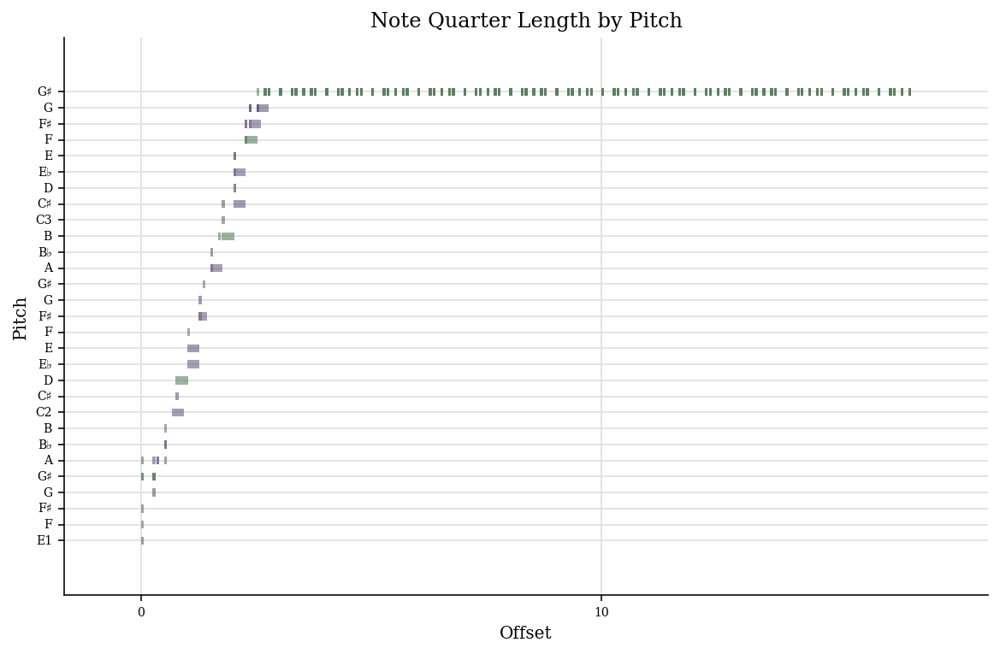

In [ ]:
music = music21.converter.parse('output.mid')
music.plot()

In [ ]:
Audio(play_music('output.mid'))